<a href="https://colab.research.google.com/github/Norod/my-colab-experiments/blob/master/MuppetFaces_SG2_ADA_Unconditional.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

####
# Unconditional Muppet Faces (SG2 ADA)
Trained from Scratch by Doron Adler (@norod78)

# Setup

In [ ]:
%tensorflow_version 1.x
import tensorflow as tf
print(tf.__version__)

import os
os.chdir('/content/')
import pickle, glob, subprocess, shutil, gdown, cv2, random, time
!git clone https://github.com/pbaylies/stylegan2-ada.git
os.chdir('/content/stylegan2-ada')

TensorFlow 1.x selected.
1.15.2
Cloning into 'stylegan2-ada'...
remote: Enumerating objects: 361, done.
remote: Total 361 (delta 0), reused 0 (delta 0), pack-reused 361
Receiving objects: 100% (361/361), 61.57 MiB | 23.37 MiB/s, done.
Resolving deltas: 100% (198/198), done.


# Utils:

In [ ]:
import numpy as np
import dnnlib
import dnnlib.tflib as tflib
from training import misc

import matplotlib.pyplot as plt
%matplotlib inline

tflib.init_tf()
synthesis_kwargs = dict(output_transform=dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True), minibatch_size=1)

def get_latest_model_path(path):
  list_of_files = glob.glob(path + '*.pkl')
  return max(list_of_files, key=os.path.getctime)

def get_latest_zip_path(path):
  list_of_files = glob.glob(path + '*.zip')
  return max(list_of_files, key=os.path.getctime)

def download_and_move_model(url, model_name, model_folder = '/content/stylegan2-ada/models/'):
  os.makedirs(model_folder, exist_ok = True)

  download_url  = 'https://drive.google.com/uc?id=%s' %url.split('?id=')[-1]
  cmd = "gdown %s" %download_url
  
  print("\n#####################")
  print("\nDownloading model from GDrive...")
  subprocess.call(cmd.split(" "))
  model_path = get_latest_model_path('/content/stylegan2-ada/')
  shutil.move(model_path, model_folder + model_name)
  print("Model downloaded & moved to %s" %(model_folder + model_name))
  print("\n#####################")

def load_network(filepath):
  print("\nLoading generator weights from \t%s..." %filepath)
  with open(filepath, 'rb') as f:
      generator_network, discriminator_network, Gs_network = pickle.load(f, encoding='latin1')
  print("StyleGAN model loaded to GPU!")
  return Gs_network

def get_model_info(Gs_network, verbose = 1):
    _N             = Gs_network.input_shape[1]
    img_dimensions = Gs_network.output_shape[1:]
    label_size     = Gs_network.input_shapes[1][1]

    c,w,h = img_dimensions
    w_vector = Gs_network.components.mapping.run(np.random.randn(1,_N), None)
    w_dim = w_vector.shape[1]

    if verbose:
        print("\n--- Model specs: ---")
        print('z-dim: %d || w-dim: %d || label_size: %d' %(_N, w_dim, label_size))
        print('img shape: (%d, %d, %d)\n' %(w,h,c))

    dlatent_avg = Gs_network.get_var('dlatent_avg')

    return _N, (w,h,c), w_dim, label_size, dlatent_avg

# 1. Download model from Google Drive:

In [ ]:
gdrive_model_link = 'https://drive.google.com/open?id=101Fxt28B2wmYyij55pNGTpumqtFPNzkx'
download_and_move_model(gdrive_model_link, 'input_model.pkl')



#####################

Model downloaded & moved to /content/stylegan2-ada/models/input_model.pkl

#####################


# 2. Load model onto the GPU:

In [ ]:
network_pkl = '/content/stylegan2-ada/models/input_model.pkl'
generator = load_network(network_pkl)
_N, (w,h,c), w_dim, label_size, dlatent_avg = get_model_info(generator, verbose = 1)


Loading generator weights from 	/content/stylegan2-ada/models/input_model.pkl...
StyleGAN model loaded to GPU!
Setting up TensorFlow plugin "fused_bias_act.cu": Compiling... Loading... Done.

--- Model specs: ---
z-dim: 512 || w-dim: 18 || label_size: 0
img shape: (1024, 1024, 3)

Setting up TensorFlow plugin "upfirdn_2d.cu": Compiling... Loading... Done.


In [ ]:
seed = int(time.time())
np.random.seed(seed=seed)
random.seed(a=seed, version=2)

def plot_imgs(model, rows, columns, truncation = 1.0, downscale_images = True):
  for i in range(rows):
    f, axarr = plt.subplots(1,columns, figsize = (24,8))
    for j in range(columns):
      img = model.run(np.random.randn(1,512), None, randomize_noise=True, truncation_psi = truncation, **synthesis_kwargs)[0]
      if downscale_images:
        img = cv2.resize(img, (512,512))
      axarr[j].imshow(img)
      axarr[j].axis('off')    
    plt.show()

## Default generation following the training distribution yields 'normal' samples:

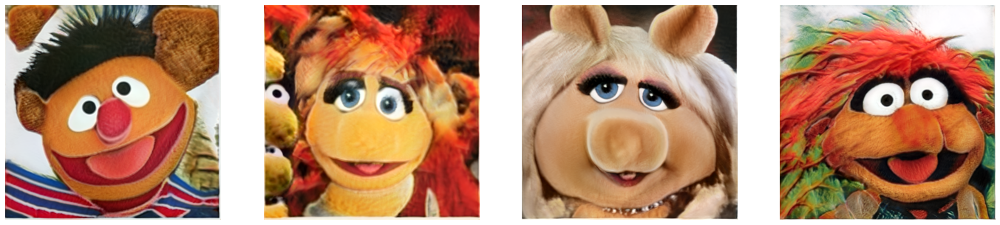

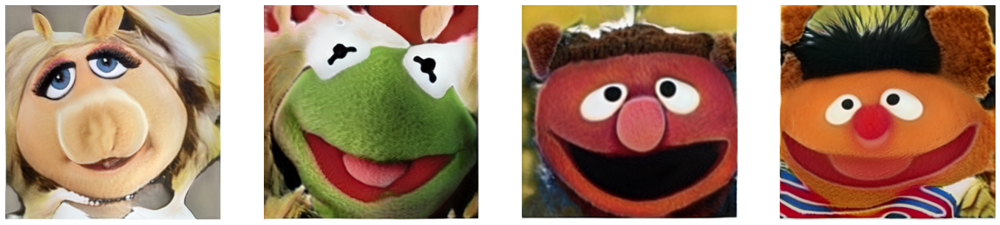

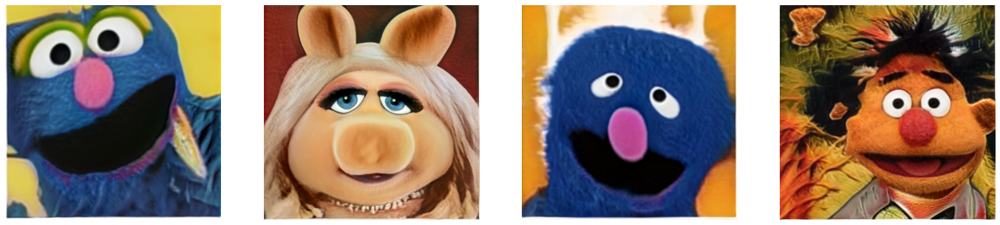

In [ ]:
plot_imgs(generator, 3, 4, truncation = 0.75)

# 3. Unload and Re-load model onto the GPU:

In [ ]:
generator = None
print('Loading networks from "%s"...' % network_pkl)
with dnnlib.util.open_url(network_pkl) as fp:
    _G, _D, Gs = pickle.load(fp)
noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]

Loading networks from "/content/stylegan2-ada/models/input_model.pkl"...


In [ ]:
from IPython import display as ipythondisplay
import io
import os
import base64
from IPython.display import HTML

def show_video(vid):
  #mp4list = [video
  #if len(mp4list) > 0:
  ext = os.path.splitext(vid)[-1][1:]
  video = io.open(vid, 'r+b').read()
  #encoded = base64.b64encode(video)
  ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
              loop controls style="height: 400px;">
              <source src="data:video/{1}';base64,{0}" type="video/{1}" />
              </video>'''.format(base64.b64encode(video).decode('ascii'), ext)))

In [ ]:
# Useful utility functions...

# Generates a list of images, based on a list of latent vectors (Z), and a list (or a single constant) of truncation_psi's.
def generate_images_in_w_space(dlatents, truncation_psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    Gs_kwargs.truncation_psi = truncation_psi
    dlatent_avg = Gs.get_var('dlatent_avg') # [component]

    imgs = []
    for row, dlatent in log_progress(enumerate(dlatents), name = "Generating images"):
        #row_dlatents = (dlatent[np.newaxis] - dlatent_avg) * np.reshape(truncation_psi, [-1, 1, 1]) + dlatent_avg
        dl = (dlatent-dlatent_avg)*truncation_psi   + dlatent_avg
        row_images = Gs.components.synthesis.run(dlatent,  **Gs_kwargs)
        imgs.append(PIL.Image.fromarray(row_images[0], 'RGB'))
    return imgs       

def generate_images(zs, truncation_psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    if not isinstance(truncation_psi, list):
        truncation_psi = [truncation_psi] * len(zs)
        
    imgs = []
    for z_idx, z in log_progress(enumerate(zs), size = len(zs), name = "Generating images"):
        Gs_kwargs.truncation_psi = truncation_psi[z_idx]
        noise_rnd = np.random.RandomState(1) # fix noise
        tflib.set_vars({var: noise_rnd.randn(*var.shape.as_list()) for var in noise_vars}) # [height, width]
        images = Gs.run(z, None, **Gs_kwargs) # [minibatch, height, width, channel]
        imgs.append(PIL.Image.fromarray(images[0], 'RGB'))
    return imgs

def generate_zs_from_seeds(seeds):
    zs = []
    for seed_idx, seed in enumerate(seeds):
        rnd = np.random.RandomState(seed)
        z = rnd.randn(1, *Gs.input_shape[1:]) # [minibatch, component]
        zs.append(z)
    return zs

# Generates a list of images, based on a list of seed for latent vectors (Z), and a list (or a single constant) of truncation_psi's.
def generate_images_from_seeds(seeds, truncation_psi):
    return generate_images(generate_zs_from_seeds(seeds), truncation_psi)

def saveImgs(imgs, location):
  for idx, img in log_progress(enumerate(imgs), size = len(imgs), name="Saving images"):
    file = location+ str(idx) + ".png"
    img.save(file)

def imshow(a, format='png', jpeg_fallback=True):
  a = np.asarray(a, dtype=np.uint8)
  str_file = BytesIO()
  PIL.Image.fromarray(a).save(str_file, format)
  im_data = str_file.getvalue()
  try:
    disp = IPython.display.display(IPython.display.Image(im_data))
  except IOError:
    if jpeg_fallback and format != 'jpeg':
      print ('Warning: image was too large to display in format "{}"; '
             'trying jpeg instead.').format(format)
      return imshow(a, format='jpeg')
    else:
      raise
  return disp

def showarray(a, fmt='png'):
    a = np.uint8(a)
    f = StringIO()
    PIL.Image.fromarray(a).save(f, fmt)
    IPython.display.display(IPython.display.Image(data=f.getvalue()))

        
def clamp(x, minimum, maximum):
    return max(minimum, min(x, maximum))
    
def drawLatent(image,latents,x,y,x2,y2, color=(255,0,0,100)):
  buffer = PIL.Image.new('RGBA', image.size, (0,0,0,0))
   
  draw = ImageDraw.Draw(buffer)
  cy = (y+y2)/2
  draw.rectangle([x,y,x2,y2],fill=(255,255,255,180), outline=(0,0,0,180))
  for i in range(len(latents)):
    mx = x + (x2-x)*(float(i)/len(latents))
    h = (y2-y)*latents[i]*0.1
    h = clamp(h,cy-y2,y2-cy)
    draw.line((mx,cy,mx,cy+h),fill=color)
  return PIL.Image.alpha_composite(image,buffer)
             
  
def createImageGrid(images, scale=0.25, rows=1):
   w,h = images[0].size
   w = int(w*scale)
   h = int(h*scale)
   height = rows*h
   cols = ceil(len(images) / rows)
   width = cols*w
   canvas = PIL.Image.new('RGBA', (width,height), 'white')
   for i,img in enumerate(images):
     img = img.resize((w,h), PIL.Image.ANTIALIAS)
     canvas.paste(img, (w*(i % cols), h*(i // cols))) 
   return canvas

def convertZtoW(latent, truncation_psi=0.7, truncation_cutoff=9):
  dlatent = Gs.components.mapping.run(latent, None) # [seed, layer, component]
  dlatent_avg = Gs.get_var('dlatent_avg') # [component]
  for i in range(truncation_cutoff):
    dlatent[0][i] = (dlatent[0][i]-dlatent_avg)*truncation_psi + dlatent_avg
    
  return dlatent

def interpolate(zs, steps):
   out = []
   for i in range(len(zs)-1):
    for index in range(steps):
     fraction = index/float(steps) 
     out.append(zs[i+1]*fraction + zs[i]*(1-fraction))
   return out

# Taken from https://github.com/alexanderkuk/log-progress
def log_progress(sequence, every=1, size=None, name='Items'):
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = int(size / 200)     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{name}: {index} / ?'.format(
                        name=name,
                        index=index
                    )
                else:
                    progress.value = index
                    label.value = u'{name}: {index} / {size}'.format(
                        name=name,
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = "{name}: {index}".format(
            name=name,
            index=str(index or '?')
        )





In [ ]:
# generate some random seeds

seeds = np.random.randint(seed,size=5)
print(seeds)

# show the seeds
#imshow(createImageGrid(generate_images_from_seeds(seeds, 0.5), 1 , 5))

[ 933511151 1438440797  501120458  726007613 1247238614]


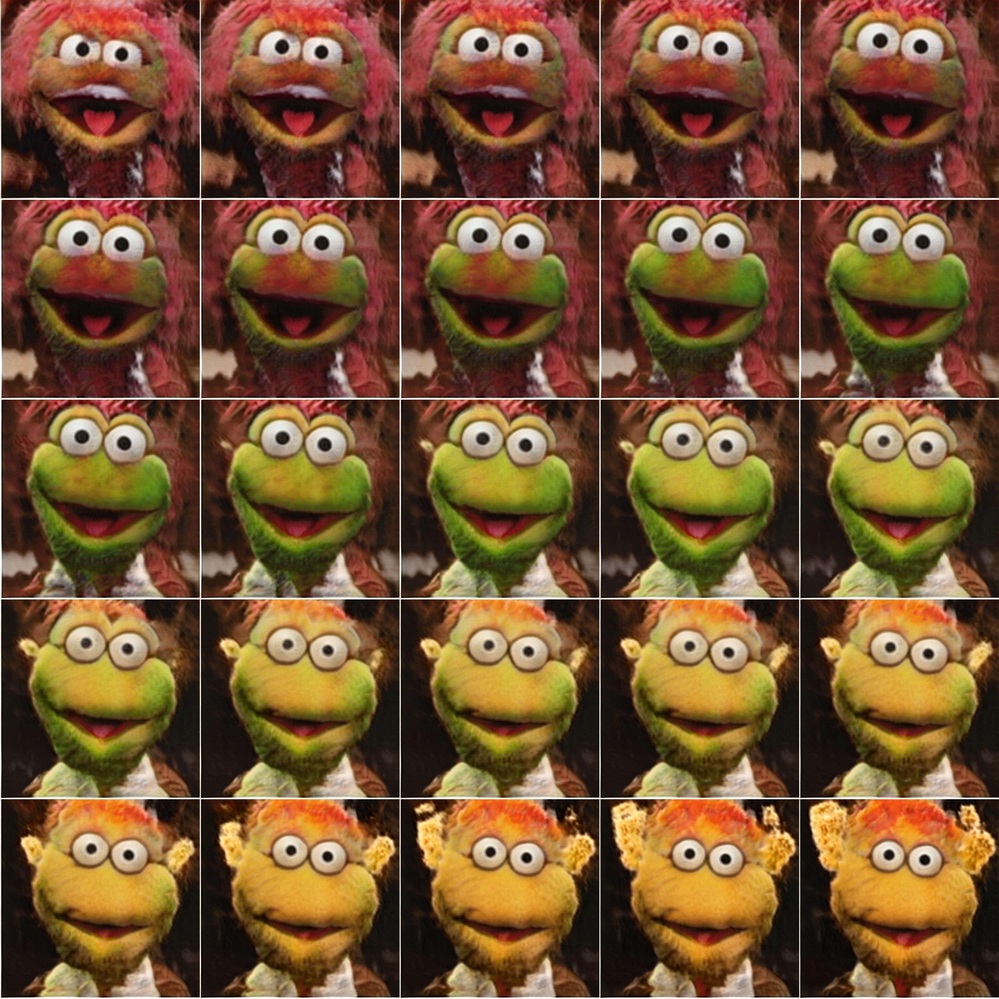

In [ ]:
import argparse
import numpy as np
import PIL.Image
import dnnlib
import dnnlib.tflib as tflib
import re
import sys
from io import BytesIO
import IPython.display
import numpy as np
from math import ceil
from PIL import Image, ImageDraw
import imageio
import pickle


import hashlib 

# Simple (Z) interpolation
zs = generate_zs_from_seeds([seeds[0] , seeds[4] ])

latent1 = zs[0]
latent2 = zs[1]

number_of_steps = 25

imgs = generate_images(interpolate([latent1,latent2],number_of_steps), 0.5)
number_of_images = len(imgs)
imshow(createImageGrid(imgs, 0.7 , 5))

In [ ]:
# generating a MP4 movie

zs = generate_zs_from_seeds([seeds[0],seeds[1],seeds[2],seeds[3] ,seeds[4],int(seeds[0] / int(2)),int(seeds[0] / int(4))])

number_of_steps = 10
imgs = generate_images(interpolate(zs,number_of_steps), 0.7)

# Example of reading a generated set of images, and storing as MP4.
%mkdir out
movieName = 'out/mov1.mp4'

with imageio.get_writer(movieName, mode='I') as writer:
    for image in log_progress(list(imgs), name = "Creating animation"):
        writer.append_data(np.array(image))
show_video(movieName)

In [ ]:
import scipy

grid_size = [3,3]
image_shrink = 1
image_zoom = 1
duration_sec = 10
smoothing_sec = 1.0
mp4_fps = 30
mp4_codec = 'libx264'
mp4_bitrate = '4M'#8M
random_seed = np.random.randint(0, 999)
mp4_file = 'random_grid_%s.mp4' % random_seed
minibatch_size = 8
truncation_psi= 0.7

num_frames = int(np.rint(duration_sec * mp4_fps))
random_state = np.random.RandomState(random_seed)

# Generate latent vectors
shape = [num_frames, np.prod(grid_size)] + Gs.input_shape[1:] # [frame, image, channel, component]
all_latents = random_state.randn(*shape).astype(np.float32)
all_latents = scipy.ndimage.gaussian_filter(all_latents, [smoothing_sec * mp4_fps] + [0] * len(Gs.input_shape), mode='wrap')
all_latents /= np.sqrt(np.mean(np.square(all_latents)))


def create_image_grid(images, grid_size=None):
    assert images.ndim == 3 or images.ndim == 4
    num, img_h, img_w, channels = images.shape

    if grid_size is not None:
        grid_w, grid_h = tuple(grid_size)
    else:
        grid_w = max(int(np.ceil(np.sqrt(num))), 1)
        grid_h = max((num - 1) // grid_w + 1, 1)

    grid = np.zeros([grid_h * img_h, grid_w * img_w, channels], dtype=images.dtype)
    for idx in range(num):
        x = (idx % grid_w) * img_w
        y = (idx // grid_w) * img_h
        grid[y : y + img_h, x : x + img_w] = images[idx]
    return grid

#def next_power_of_2(x):  
#  return 1 if x == 0 else 2**(x - 1).bit_length()

# Frame generation func for moviepy.
def make_frame(t):
    frame_idx = int(np.clip(np.round(t * mp4_fps), 0, num_frames - 1))
    latents = all_latents[frame_idx]
    fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    images = Gs.run(latents, None, truncation_psi=truncation_psi,
                          randomize_noise=False, output_transform=fmt, 
                          minibatch_size=16)

    grid = create_image_grid(images, grid_size)
    if image_zoom > 1:
        grid = scipy.ndimage.zoom(grid, [image_zoom, image_zoom, 1], order=0)
    if grid.shape[2] == 1:
        grid = grid.repeat(3, 2) # grayscale => RGB
    return grid

# Generate video.
import moviepy.editor
video_clip = moviepy.editor.VideoClip(make_frame, duration=duration_sec)
video_clip.write_videofile(mp4_file, fps=mp4_fps, codec=mp4_codec, bitrate=mp4_bitrate)

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)2088960/45929032 bytes (4.5%)6234112/45929032 bytes (13.6%)10371072/45929032 bytes (22.6%)14557184/45929032 bytes (31.7%)18808832/45929032 bytes (41.0%)22863872/45929032 bytes (49.8%)26894336/45929032 bytes (58.6%)31006720/45929032 bytes (67.5%)35160064/45929032 bytes (76.6%)39239680/45929032 bytes (85.4%)43343872/45929032 bytes (94.4%)45929032/45929032 bytes (100.0%)
  Done
File saved as /root

100%|█████████▉| 300/301 [01:03<00:00,  4.72it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: random_grid_523.mp4 



In [ ]:
from google.colab import files
show_video(mp4_file)


# Latent representations 

In [ ]:
def download_and_extract_latents(url, zip_name, target_folder = '/content/stylegan2-ada/latents/'):
    os.makedirs(target_folder, exist_ok = True)

    download_url  = 'https://drive.google.com/uc?id=%s' %url.split('?id=')[-1]
    cmd = "gdown %s" %download_url
    
    print("\n#####################")
    print("\nDownloading zip from GDrive...")
    subprocess.call(cmd.split(" "))
    zip_path = get_latest_zip_path('/content/stylegan2-ada/')
    shutil.move(zip_path, target_folder + zip_name)
    target_zip = str(target_folder) + str(zip_name)
    print("Zip downloaded & moved to %s" %(target_zip))
    
    !unzip -n -j "$target_zip" -d "$target_folder"
    print("\n#####################")

In [ ]:
gdrive_latents_link = 'https://drive.google.com/open?id=1kHH6FL0uxExsrybBonOFFNRhZUxS0Kb6'
download_and_extract_latents(gdrive_latents_link, 'sample_latents.zip')


#####################

Zip downloaded & moved to /content/stylegan2-ada/latents/sample_latents.zip
Archive:  /content/stylegan2-ada/latents/sample_latents.zip
  inflating: /content/stylegan2-ada/latents/Kermit_dlatents.npz  
  inflating: /content/stylegan2-ada/latents/Ernie_dlatents.npz  
  inflating: /content/stylegan2-ada/latents/Fozzy_dlatents.npz  
  inflating: /content/stylegan2-ada/latents/Elmo_dlatents.npz  
  inflating: /content/stylegan2-ada/latents/Bert_dlatents.npz  

#####################


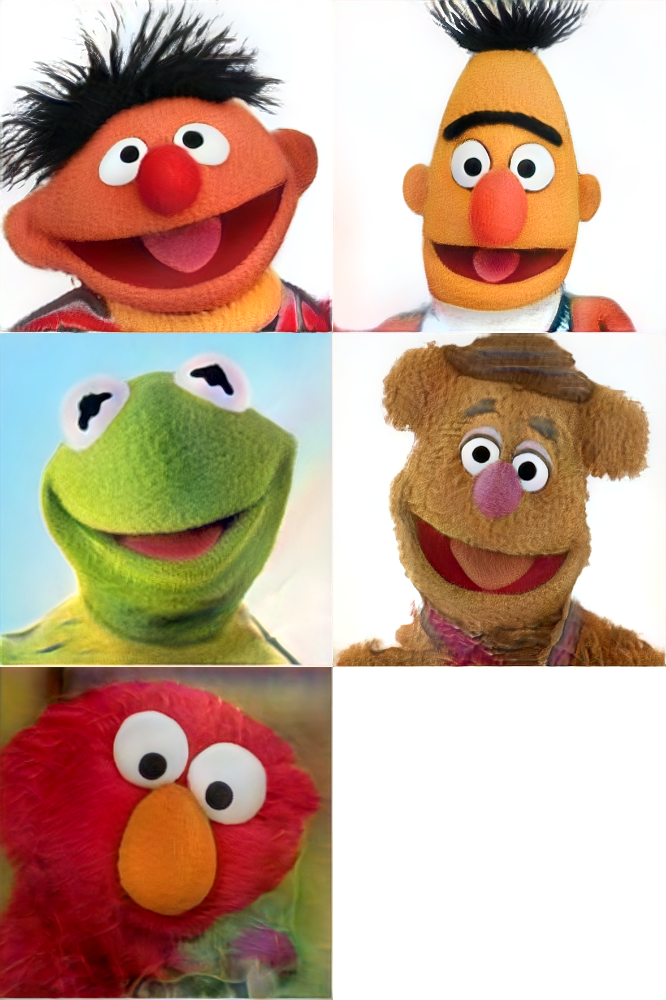

In [ ]:
import numpy as np
from glob import glob

dls = []
file_names = glob('/content/stylegan2-ada/latents/*.npz')

for f in file_names:
  latent_vectorz = np.load(f)
  latent_vector = latent_vectorz.f.dlatents
  dls.append(latent_vector.reshape((1, 18, 512)))  

imgs = generate_images_in_w_space(dls,1)
grid=createImageGrid(images=imgs,scale=1,rows=3)
imshow(grid)

In [ ]:
number_of_steps = 60

video_frames = generate_images_in_w_space(interpolate(dls,number_of_steps), 1.0)
movieName = 'out/Muppets-Latent-Interpolation.mp4'

with imageio.get_writer(movieName, mode='I') as writer:
    for image in log_progress(list(video_frames), name = "Creating animation"):
        writer.append_data(np.array(image))

In [ ]:
with imageio.get_writer(movieName, mode='I') as writer:
    for image in log_progress(list(imgs), name = "Creating animation"):
        writer.append_data(np.array(image))
print("Download movie from: " + str(movieName))
print("For some reaon it looks weird in the inline player")
show_video(movieName)

Download movie from: out/Muppets-Latent-Interpolation.mp4
For some reaon it looks weird in the inline player
